# Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

## Rubric Points
Here I will consider the rubric points individually and describe how I addressed each point in my implementation.

## Camera Calibration

### Briefly state how you computed the camera matrix and distortion coefficients. Provide an example of a distortion corrected calibration image.

I start by preparing "object points", which will be the (x, y, z) coordinates of the chessboard corners in the world. Here I am assuming the chessboard is fixed on the (x, y) plane at z=0, such that the object points are the same for each calibration image. Thus, objp is just a replicated array of coordinates, and objpoints will be appended with a copy of it every time I successfully detect all chessboard corners in a test image. imgpoints will be appended with the (x, y) pixel position of each of the corners in the image plane with each successful chessboard detection.

I then used the output objpoints and imgpoints to compute the camera calibration and distortion coefficients using the cv2.calibrateCamera() function. I applied this distortion correction to the test image using the cv2.undistort() function and obtained the result.

### Imports

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

### Helper Functions

In [2]:
import math

# show images rows*cols
def imgs_show(imgs, rows, cols, scalex=40, scaley=40):
    f, axarr = plt.subplots(rows, cols, figsize=(rows*scalex, cols*scalex))
    for idx, img in enumerate(imgs):
        row = int(idx / cols)
        col = idx % cols
        if cols == 1:
            axarr[row].imshow(img, aspect='auto')
        else:
            axarr[row, col].imshow(img, aspect='auto')
            
# plot two images side by side
def plt2(img1, title1, img2, title2, cmap='gray'):
    # Visualize undirstorsion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.set_title(title1, fontsize=16)
    ax1.imshow(img1)
    ax2.set_title(title2, fontsize=16)
    ax2.imshow(img2, cmap='gray')

### Image Explore and Calibration

In [3]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)

nx = 9 #TODO: enter the number of inside corners in x
ny = 6 #TODO: enter the number of inside corners in y

objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
# images = glob.glob('camera_cal/calibration*.jpg')
images = glob.glob('camera_cal/calibration*.jpg')
imagesWanted = {'camera_cal/calibration17.jpg', 
                'camera_cal/calibration18.jpg', 
                'camera_cal/calibration2.jpg',
                'camera_cal/calibration8.jpg', 
                'camera_cal/calibration9.jpg'}

# Result Images
imgsWithCorners = [] 
imgsCorrected = []
mtxs = []
dists = []
Ms = []
warpeds = []

# Step through the list and search for chessboard corners
for fname in images:
    if not(fname in imagesWanted): continue
    
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)

    # If found, add object points, image points
    if ret == True:
        print(fname + ' : ' + 'True')
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        imgCorners = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        imgsWithCorners.append(imgCorners)
        
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1::-1], None, None)
        undist = cv2.undistort(img, mtx, dist, None, mtx)
        imgsCorrected.append(undist)
        mtxs.append(mtx)
        dists.append(dists)
    else:
        print(fname + ' : ' + 'False')


    # https://www.programcreek.com/python/example/71381/cv2.findChessboardCorners
    # Example 5
    # Choose offset from image corners to plot detected corners
    # This should be chosen to present the result at the proper aspect ratio
    # My choice of 100 pixels is not exact, but close enough for our purpose here
    offset = 100 # offset for dst points
    # Grab the image shape
    img_size = (gray.shape[1], gray.shape[0])

    # For source points I'm grabbing the outer four detected corners
    src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
    # print(src)
    # For destination points, I'm arbitrarily choosing some points to be
    # a nice fit for displaying our warped result
    # again, not exact, but close enough for our purposes
    dst = np.float32([[offset, offset], [img_size[0]-offset, offset],
                                 [img_size[0]-offset, img_size[1]-offset],
                                 [offset, img_size[1]-offset]])

    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(undist, M, img_size)
    Ms.append(M)
    warpeds.append(warped)

camera_cal/calibration8.jpg : True
camera_cal/calibration2.jpg : True
camera_cal/calibration17.jpg : True
camera_cal/calibration9.jpg : True
camera_cal/calibration18.jpg : True


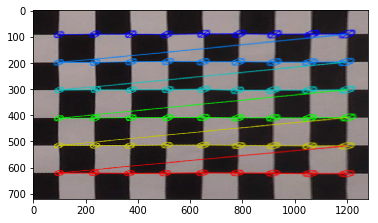

In [4]:
plt.imshow(warpeds[3]) 

In [5]:
# show the results
imgsAll = [j for i in zip(imgsWithCorners,imgsCorrected, warpeds) for j in i]
imgs_show(imgsAll, len(imgsCorrected), 3)

### restruct the codes

In [6]:
## restruct code

def read_chessboard_images(glob_path='camera_cal/calibration*.jpg'):
    """
    glob_path: path contains chessboard images, like "camera_cal/calibration*.jpg"
    """
    f_imgs = glob.glob(glob_path)
    imgs = []

    # Step through the list and search for chessboard corners
    for f in f_imgs:
        img = cv2.imread(f)
        imgs.append(img)
    return imgs


def calibrate_camera(images, nx=9, ny=6):
    """"
    images = paths to the images used to calibrate the camera
    nx = Number of inside corners in x
    ny = Number of inside corners in y
    """

    # Prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((nx * ny, 3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Step through the list and search for chessboard corners
    img = None
    for fname in images:    
        img = cv2.imread(fname)
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

    # Camera calibration, given object points, image points, and the shape of the grayscale image
    if (len(objpoints) > 0):
        # Camera successfully calibrated.
        print("Camera successfully calibrated.")
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    else:
        # Unable to calibrate the camera.
        print("Unable to calibrate the camera.")
        ret, mtx, dist, rvecs, tvecs = (None, None, None, None, None)

    return ret, mtx, dist, rvecs, tvecs

def save_mtx_dist(pickle_path="./wide_dist_pickle.p"):
    # Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
    dist_pickle = {}
    dist_pickle["mtx"] = mtx
    dist_pickle["dist"] = dist
    pickle.dump(dist_pickle, open(pickle_path, "wb" ))


# Define a function that takes an image, number of x and y points,
# camera matrix and distortion coefficients
def corners_unwarp(img, nx, ny, mtx, dist):
    # Use the OpenCV undistort() function to remove distortion
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # Convert undistorted image to grayscale
    gray = cv2.cvtColor(undist, cv2.COLOR_BGR2GRAY)
    # Search for corners in the grayscaled image
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    if ret == True:
        # If we found corners, draw them! (just for fun)
        cv2.drawChessboardCorners(undist, (nx, ny), corners, ret)
        # Choose offset from image corners to plot detected corners
        # This should be chosen to present the result at the proper aspect ratio
        # My choice of 100 pixels is not exact, but close enough for our purpose here
        offset = 100 # offset for dst points
        # Grab the image shape
        img_size = (gray.shape[1], gray.shape[0])

        # For source points I'm grabbing the outer four detected corners
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        # For destination points, I'm arbitrarily choosing some points to be
        # a nice fit for displaying our warped result
        # again, not exact, but close enough for our purposes
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset],
                                     [img_size[0]-offset, img_size[1]-offset],
                                     [offset, img_size[1]-offset]])
        # Given src and dst points, calculate the perspective transform matrix
        M = cv2.getPerspectiveTransform(src, dst)
        # Warp the image using OpenCV warpPerspective()
        warped = cv2.warpPerspective(undist, M, img_size)

    # Return the resulting image and matrix
    return warped, M

## Pipeline (single images)

### 1. Provide an example of a distortion-corrected image.

To demonstrate this step, I will describe how I apply the distortion correction to two of the test images like this one: 


In [7]:
# read chessboard images
glob_path = 'camera_cal/calibration*.jpg'
cb_imgs = glob.glob(glob_path)

# Calibrate camera        
ret, mtx, dist, rvecs, tvecs = calibrate_camera(cb_imgs)

Camera successfully calibrated.


In [8]:
# Test undistortion on an image
img1 = cv2.imread('./test_images/test1.jpg', )
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img_size1 = (img1.shape[1], img1.shape[0])
undist1 = cv2.undistort(img1, mtx, dist, None, mtx)

img2 = cv2.imread('./test_images/test2.jpg')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
img_size2 = (img2.shape[1], img2.shape[0])
undist2 = cv2.undistort(img2, mtx, dist, None, mtx)

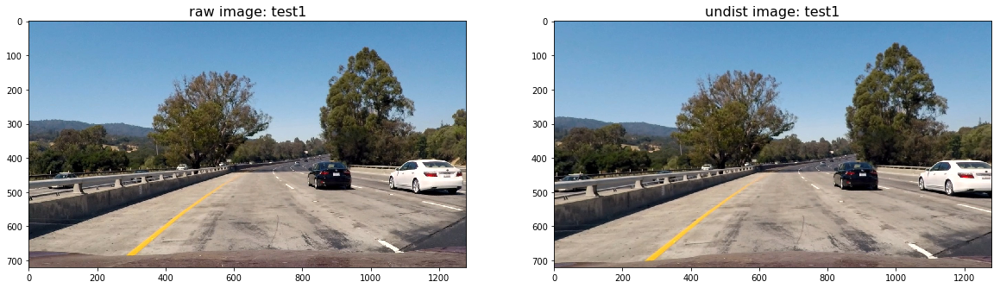

In [9]:
plt2(img1, 'raw image: test1', undist1, 'undist image: test1', cmap=None)

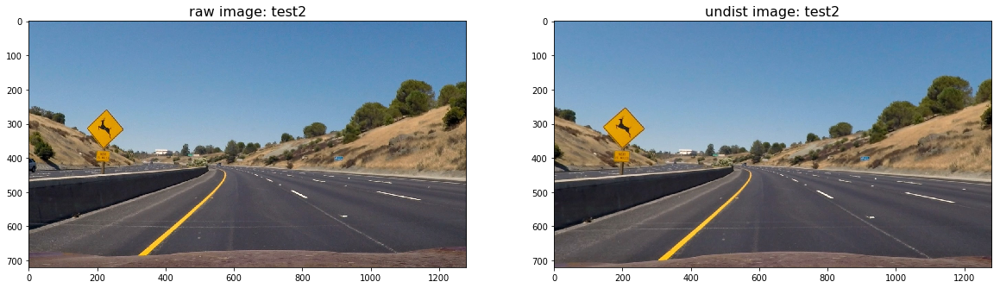

In [10]:
plt2(img2, 'raw image: test2', undist2, 'undist image: test2', cmap=None)

In [11]:
img1_raw, img2_raw = img1, img2

In [12]:
img1, img2 = undist1, undist2

In [13]:
cv2.imwrite("output_images/undist1.jpg", cv2.cvtColor(undist1, cv2.COLOR_RGB2BGR))

True

In [14]:
cv2.imwrite("output_images/undist2.jpg", cv2.cvtColor(undist2, cv2.COLOR_RGB2BGR))

True

### 2. Describe how (and identify where in your code) you used color transforms, gradients or other methods to create a thresholded binary image. Provide an example of a binary image result.

This part is the key to the lane detection. I tried HLS color space, x and y gradient, magnitude and direction gradient, and their combination. I tested different parameter values, and finally got the best result.

In [15]:
def hls_thresh(img, thresh = (90,255)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = hls[:,:,2]
    binary = np.zeros_like(S)
    binary[(S > thresh[0]) & (S <= thresh[1])] = 1
    
    # Return the binary image
    return binary


def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0,255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    # Return the binary image
    return binary_output


def magnitude_thresh(img, sobel_kernel=3, thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255
    gradmag = (gradmag/scale_factor).astype(np.uint8)
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= thresh[0]) & (gradmag <= thresh[1])] = 1

    # Return the binary image
    return binary_output


# Define a function to threshold an image for a given range and Sobel kernel
def direct_thresh(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction,
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output = np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output


def combined_thresh(img, ksize = 15, 
                    thresh_grad_x = (0, 255), thresh_grad_y = (0, 255), 
                    thresh_mag = (0, 255), thresh_dir = (0, np.pi/2),
                    thresh_hls = (90,255)):

    # Apply each of the thresholding functions
    grad_x = abs_sobel_thresh(img, orient='x', sobel_kernel=ksize, thresh=thresh_grad_x)
    grad_y = abs_sobel_thresh(img, orient='y', sobel_kernel=ksize, thresh=thresh_grad_y)
    mag = magnitude_thresh(img, sobel_kernel=ksize, thresh=thresh_mag)
    dir = direct_thresh(img, sobel_kernel=ksize, thresh=thresh_dir)
    hls = hls_thresh(img, thresh=thresh_hls)
    combined = np.zeros_like(dir)
    combined[((grad_x == 1) & (grad_y == 1)) | ((mag == 1) & (dir == 1)) | (hls == 1)] = 1
    
    # Return the binary image
    return combined

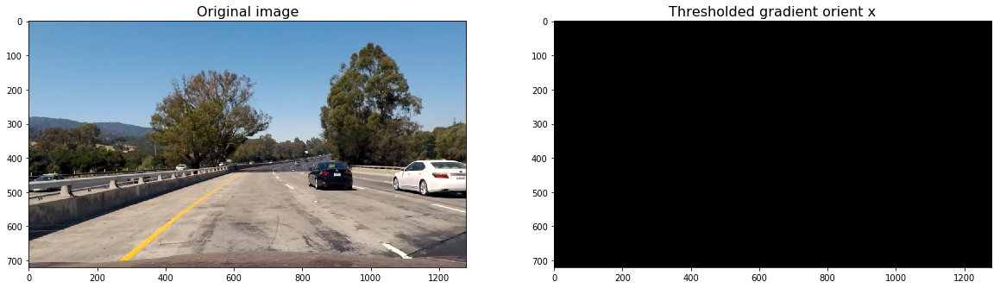

In [16]:
# test: using default parameters
grad_x = abs_sobel_thresh(img1)
plt2(img1, 'Original image', grad_x, 'Thresholded gradient orient x')

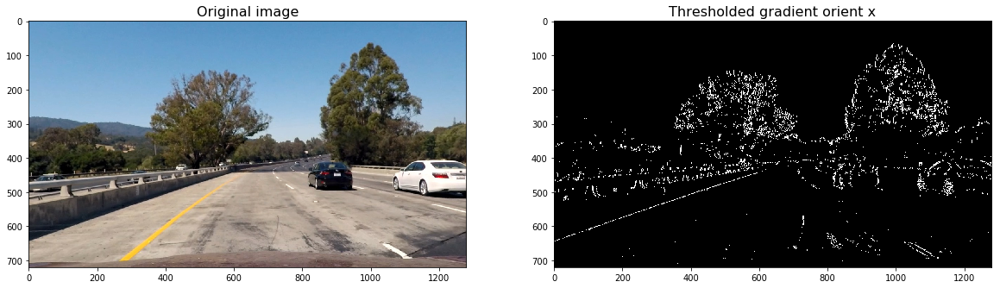

In [17]:
# test: adjusting sobel_kernel and thresh
grad_x = abs_sobel_thresh(img1, sobel_kernel=3, thresh=(30, 100))
plt2(img1, 'Original image', grad_x, 'Thresholded gradient orient x')

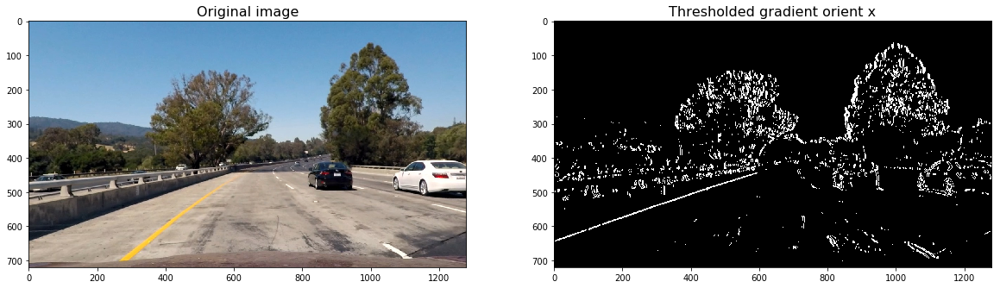

In [18]:
# test: adjusting sobel_kernel and thresh
grad_x = abs_sobel_thresh(img1, sobel_kernel=15, thresh=(30, 100))
plt2(img1, 'Original image', grad_x, 'Thresholded gradient orient x')

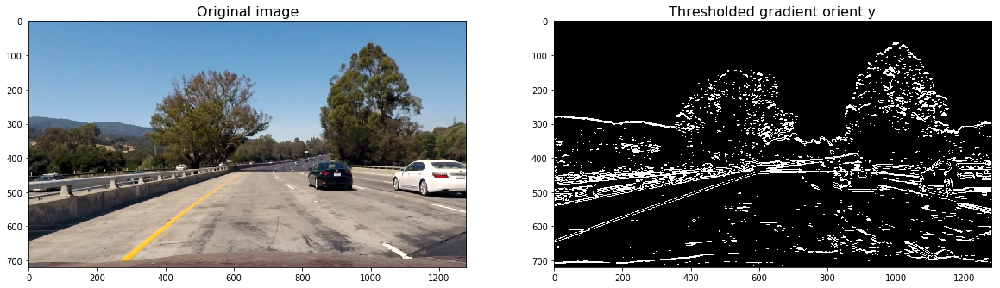

In [19]:
# test: y
grad_y = abs_sobel_thresh(img1, orient='y', sobel_kernel=15, thresh=(30, 100))
plt2(img1, 'Original image', grad_y, 'Thresholded gradient orient y')

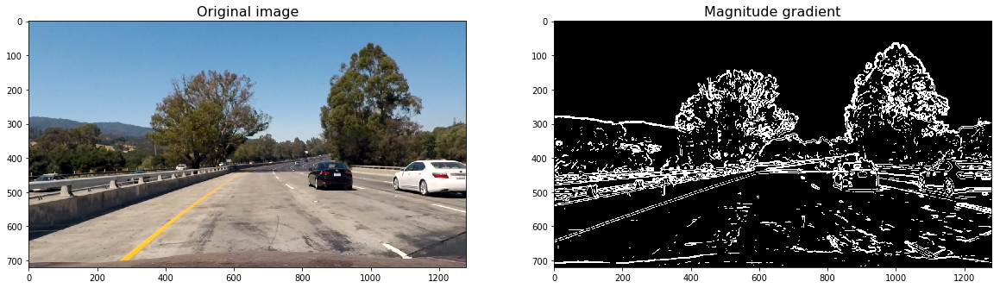

In [20]:
# test: mag
mag = magnitude_thresh(img1, sobel_kernel=15, thresh=(30, 100))
plt2(img1, 'Original image', mag, 'Magnitude gradient')

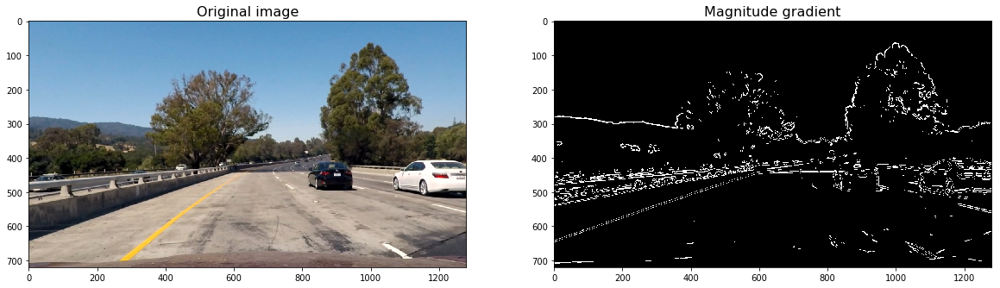

In [21]:
# test: mag, adjusting thresh
mag = magnitude_thresh(img1, sobel_kernel=15, thresh=(60, 100))
plt2(img1, 'Original image', mag, 'Magnitude gradient')

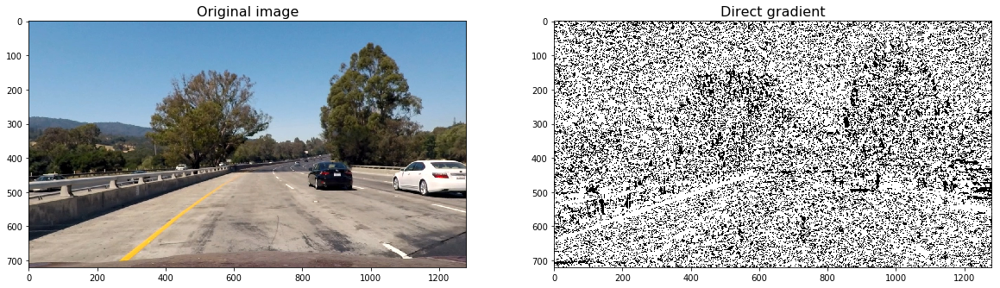

In [22]:
# test: direct
dir = direct_thresh(img1, sobel_kernel=15, thresh=(0.5, 1.5))
plt2(img1, 'Original image', dir, 'Direct gradient')

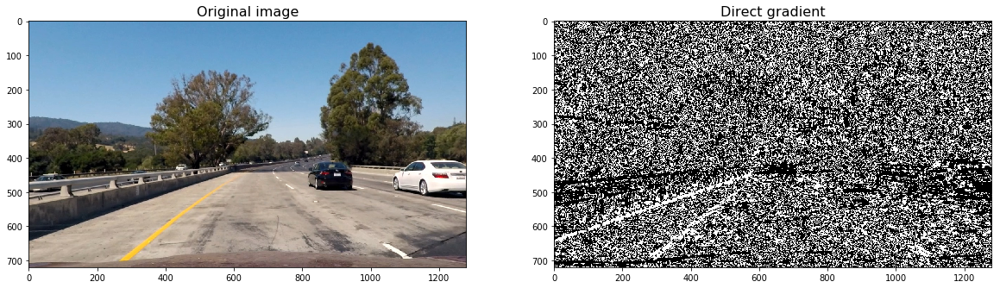

In [23]:
# test: direct, adjusting thresh
dir = direct_thresh(img1, sobel_kernel=15, thresh=(0.7, 1.3))
plt2(img1, 'Original image', dir, 'Direct gradient')

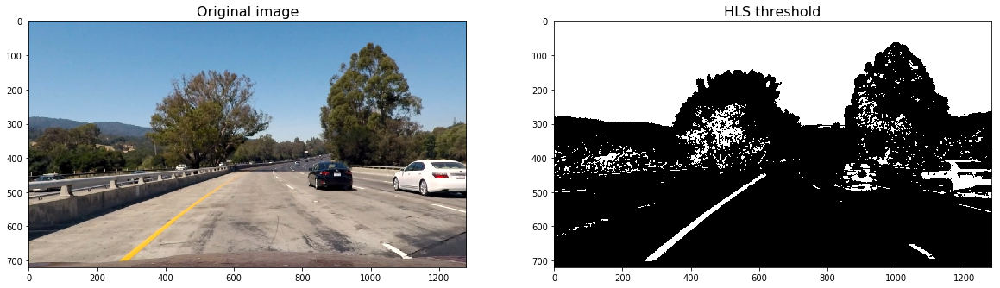

In [24]:
# test: hls
hls = hls_thresh(img1, thresh=(100, 255))
plt2(img1, 'Original image', hls, 'HLS threshold')

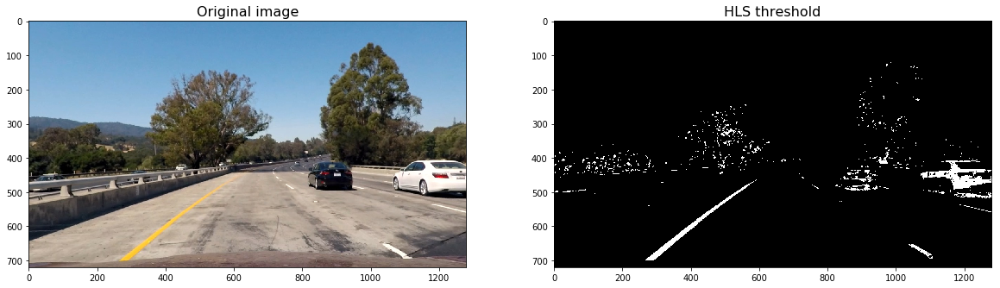

In [25]:
# test: hls, adjusting thresh
hls = hls_thresh(img1, thresh=(150, 255))
plt2(img1, 'Original image', hls, 'HLS threshold')

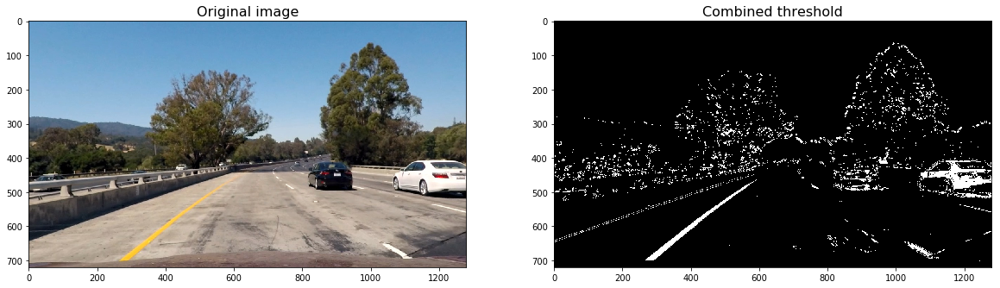

In [26]:
# combine them all
cmb1 = combined_thresh(img1, 15, 
                      thresh_grad_x=(30, 100), thresh_grad_y=(30, 100), 
                      thresh_mag=(60, 100), thresh_dir=(0.7, 1.3), thresh_hls=(150, 255))
plt2(img1, 'Original image', cmb1, 'Combined threshold')

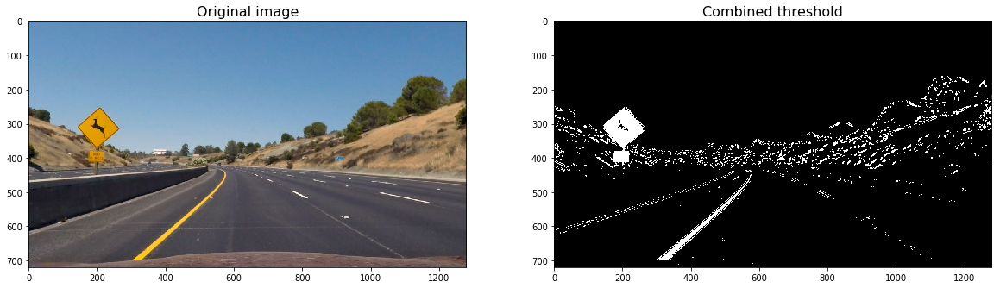

In [27]:
cmb2 = combined_thresh(img2, 15, 
                      thresh_grad_x=(30, 100), thresh_grad_y=(30, 100), 
                      thresh_mag=(60, 100), thresh_dir=(0.7, 1.3), thresh_hls=(150, 255))
plt2(img2, 'Original image', cmb2, 'Combined threshold', cmap=None)

In [28]:
cv2.imwrite("output_images/grad_x.jpg", grad_x.astype('uint8') * 255)
cv2.imwrite("output_images/grad_x.jpg", grad_x.astype('uint8') * 255)
cv2.imwrite("output_images/grad_x.jpg", grad_x.astype('uint8') * 255)
cv2.imwrite("output_images/grad_x.jpg", grad_x.astype('uint8') * 255)
cv2.imwrite("output_images/grad_x.jpg", grad_x.astype('uint8') * 255)
cv2.imwrite("output_images/grad_x.jpg", grad_x.astype('uint8') * 255)

# cv2.imwrite("output_images/grad_y.jpg", cv2.cvtColor(grad_y, cv2.COLOR_RGB2BGR))
# cv2.imwrite("output_images/mag.jpg", cv2.cvtColor(mag, cv2.COLOR_RGB2BGR))
# cv2.imwrite("output_images/dir.jpg", cv2.cvtColor(dir, cv2.COLOR_RGB2BGR))
# cv2.imwrite("output_images/hls.jpg", cv2.cvtColor(hls, cv2.COLOR_RGB2BGR))

True

### 3. Describe how (and identify where in your code) you performed a perspective transform and provide an example of a transformed image.

The **warp** function bellow acts perspective transform. It takes as inputs an image (img), as well as source (src) and destination (dst) points. 

In [29]:
# Define perspective transform function
def warp(img, src_coordinates=None, dst_coordinates=None):
    # Define calibration box in source (original) and destination (desired or warped) coordinates
    img_size = (img.shape[1], img.shape[0])
    
    
    if src_coordinates is None:
        src_coordinates = np.float32(
            [[280,  700],  # Bottom left
             [595,  460],  # Top left
             [725,  460],  # Top right
             [1125, 700]]) # Bottom right
        
    if dst_coordinates is None:
        dst_coordinates = np.float32(
            [[250,  720],  # Bottom left
             [250,    0],  # Top left
             [1065,   0],  # Top right
             [1065, 720]]) # Bottom right   

    # Compute the perspective transfor, M
    M = cv2.getPerspectiveTransform(src_coordinates, dst_coordinates)

    # Compute the inverse perspective transfor also by swapping the input parameters
    Minv = cv2.getPerspectiveTransform(dst_coordinates, src_coordinates)
    
    # Create warped image - uses linear interpolation
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)

    return warped, M, Minv

In [30]:
# Run the function
src_coordinates = np.float32(
    [[280,  700],  # Bottom left
     [595,  460],  # Top left
     [725,  460],  # Top right
     [1125, 700]]) # Bottom right

dst_coordinates = np.float32(
    [[250,  720],  # Bottom left
     [250,    0],  # Top left
     [1065,   0],  # Top right
     [1065, 720]]) # Bottom right   

warped_img1, M , Minv  = warp(img1, src_coordinates, dst_coordinates)

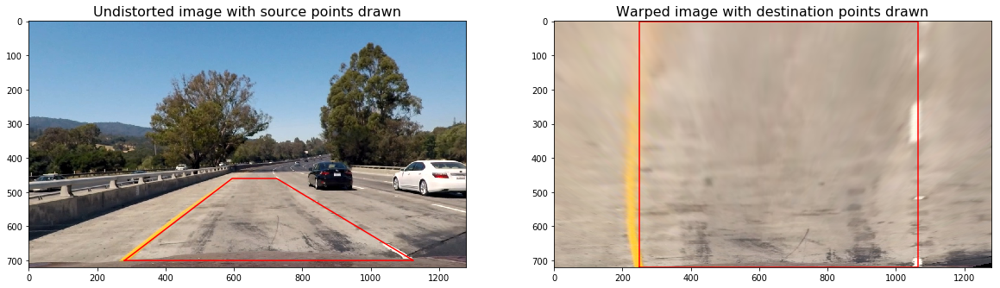

In [31]:
from matplotlib.patches import Polygon


# Visualize undirstorsion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.set_title('Undistorted image with source points drawn', fontsize=16)
ax1.plot(Polygon(src_coordinates).get_xy()[:, 0], Polygon(src_coordinates).get_xy()[:, 1], color='red')
ax1.imshow(img1)

ax2.set_title('Warped image with destination points drawn', fontsize=16)
ax2.plot(Polygon(dst_coordinates).get_xy()[:, 0], Polygon(dst_coordinates).get_xy()[:, 1], color='red')
ax2.imshow(warped_img1)

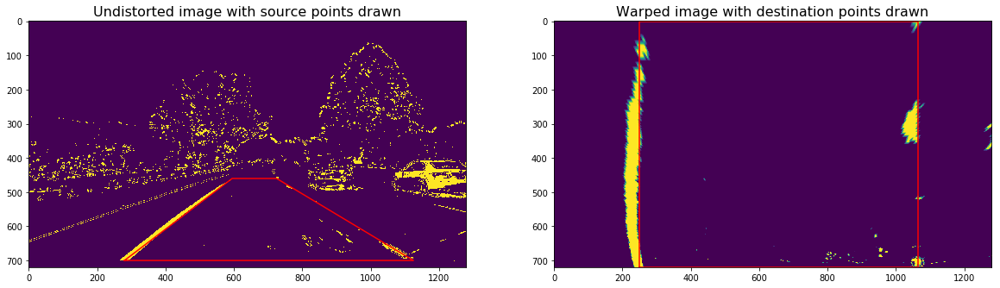

In [32]:
warped_cmb1, M1 , Minv1  = warp(cmb1, src_coordinates, dst_coordinates)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.set_title('Undistorted image with source points drawn', fontsize=16)
ax1.plot(Polygon(src_coordinates).get_xy()[:, 0], Polygon(src_coordinates).get_xy()[:, 1], color='red')
ax1.imshow(cmb1)

ax2.set_title('Warped image with destination points drawn', fontsize=16)
ax2.plot(Polygon(dst_coordinates).get_xy()[:, 0], Polygon(dst_coordinates).get_xy()[:, 1], color='red')
ax2.imshow(warped_cmb1)

### 4. Describe how (and identify where in your code) you identified lane-line pixels and fit their positions with a polynomial?

I use histgram, windowing and 2nd order polynomial fitting to find the lane lines as following.

### Hist
Get histgram for detecting the peaks inhinting the lanes

In [33]:
def get_hist(img):
    return np.sum(img[img.shape[0]//2:, :], axis=0)

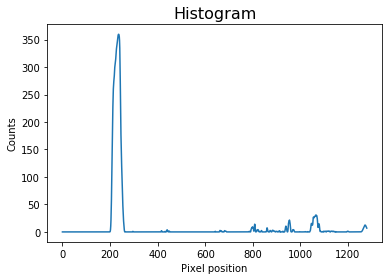

In [34]:
cmb1_warped, M1 , Minv1   = warp(cmb1)
hist1 = get_hist(cmb1_warped)

# Plot the results
plt.title('Histogram', fontsize=16)
plt.xlabel('Pixel position')
plt.ylabel('Counts')
plt.plot(hist1)

### Windowing
Use windowing to detect pixels for the lane lines.

In [35]:
def find_lane_pixels(binary_warped):

    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped)) * 255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 3) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 3) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img

### Polyfit
Use 2d order polyfit to get the final lane lines.

In [36]:
def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
    
    # Draw left and right lines
    for index in range(binary_warped.shape[0]):
        cv2.circle(out_img, (int(left_fitx[index]), int(ploty[index])), 3, (255,255,0))
        cv2.circle(out_img, (int(right_fitx[index]), int(ploty[index])), 3, (255,255,0))

    # Plots the left and right polynomials on the lane lines
#     plt.plot(left_fitx, ploty, color='yellow')
#     plt.plot(right_fitx, ploty, color='yellow')

    return (left_fit, right_fit), (left_fitx, ploty), (right_fitx, ploty), out_img.astype(np.uint8)

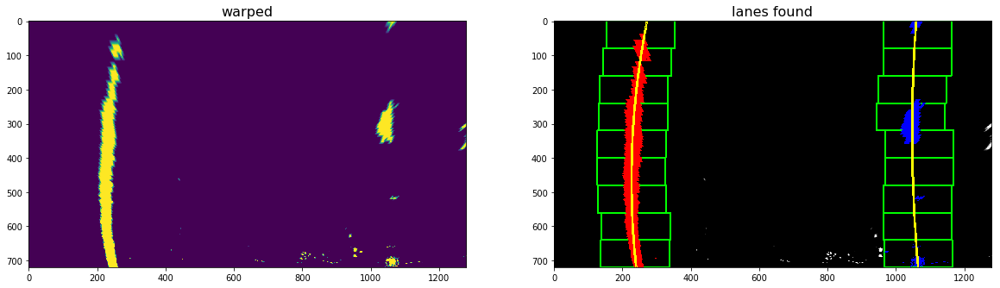

In [37]:
lines_fit1, left_points1, right_points1, out_img1 = fit_polynomial(cmb1_warped)
plt2(cmb1_warped, 'warped', out_img1, 'lanes found', cmap=None)

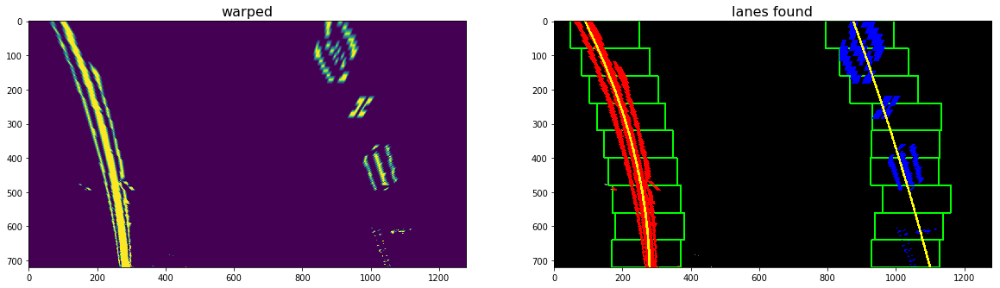

In [38]:
cmb2_warped, M2 , Minv2 = warp(cmb2)
lines_fit2, left_points2, right_points2, out_img2 = fit_polynomial(cmb2_warped)
plt2(cmb2_warped, 'warped', out_img2, 'lanes found', cmap=None)

In [39]:
def fit_similar_lines(img, line_fits=None):
    if line_fits is None:
        return fit_polynomial(img)
    
    left_fit = line_fits[0]
    right_fit = line_fits[1]
    
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
    right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # If any of the lines could not be found, 
    # perform a more exhaustive search
    if (leftx.size == 0 or rightx.size == 0):
        return fit_polynomial(img)
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, img.shape[0] - 1, img.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((img, img, img))*255
    window_img = np.zeros_like(out_img)

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx - margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx + margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx - margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx + margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    out_img = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    for index in range(img.shape[0]):
        cv2.circle(out_img, (int(left_fitx[index]), int(ploty[index])), 3, (255,255,0))
        cv2.circle(out_img, (int(right_fitx[index]), int(ploty[index])), 3, (255,255,0))

    return (left_fit, right_fit), (left_fitx, ploty), (right_fitx, ploty), out_img.astype(np.uint8)

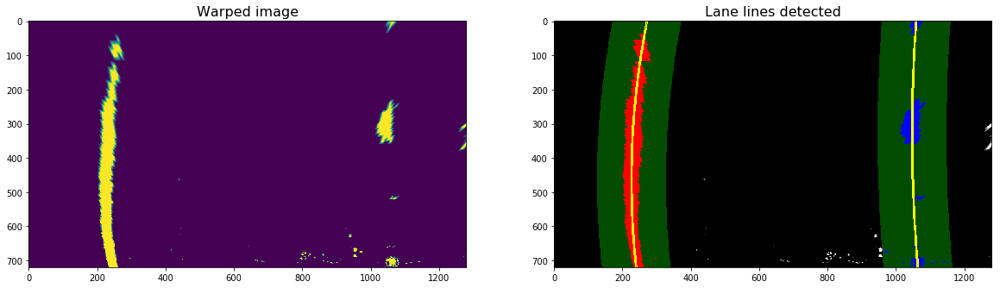

In [40]:
# Run the function
# Notice I am passing the same image than before.
# In a video stream, it should be passed the next frame.
lines_fit1, left_points1, right_points1, out_img1 = fit_similar_lines(cmb1_warped, lines_fit1)

# Plot the results
plt2(cmb1_warped, 'Warped image', out_img1, 'Lane lines detected', cmap=None)

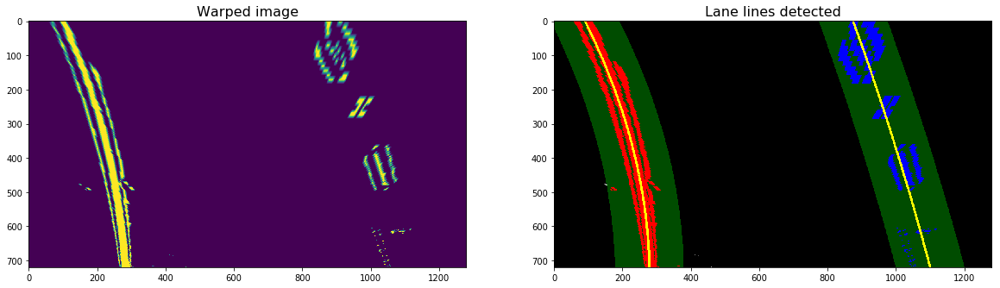

In [41]:
lines_fit2, left_points2, right_points2, out_img2 = fit_similar_lines(cmb2_warped, lines_fit2)
plt2(cmb2_warped, 'Warped image', out_img2, 'Lane lines detected', cmap=None)

### 5. Describe how (and identify where in your code) you calculated the radius of curvature of the lane and the position of the vehicle with respect to center.

I use **curvature_radius** and **car_offset** bellow.

In [42]:
def curvature_radius (leftx, rightx, img_shape, xm_per_pix=3.7/800, ym_per_pix = 25/720):
    ploty = np.linspace(0, img_shape[0] - 1, img_shape[0])
    
    leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
    rightx = rightx[::-1]  # Reverse to match top-to-bottom in y
    
    # Fit a second order polynomial to pixel positions in each fake lane line
    left_fit = np.polyfit(ploty, leftx, 2)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fit = np.polyfit(ploty, rightx, 2)
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 25/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/800 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    y_eval = np.max(ploty)
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    # Now our radius of curvature is in meters
    return (left_curverad, right_curverad)

In [43]:
# Run the function
curvature_rads1 = curvature_radius(leftx=left_points1[0], rightx=right_points1[0], img_shape = cmb1_warped.shape)

# Print the results
print('Left line curvature:', curvature_rads1[0], 'm')
print('Right line curvature:', curvature_rads1[1], 'm')

Left line curvature: 619.04571881 m
Right line curvature: 1165.29454421 m


In [44]:
def car_offset(leftx, rightx, img_shape, xm_per_pix=3.7/800):
    ## Image mid horizontal position 
    mid_imgx = img_shape[1]//2
        
    ## Car position with respect to the lane
    car_pos = (leftx[-1] + rightx[-1])/2
    
    ## Horizontal car offset 
    offsetx = (mid_imgx - car_pos) * xm_per_pix

    return offsetx

In [45]:
# Run the function
offsetx1 = car_offset(leftx=left_points1[0], rightx=right_points1[0], img_shape=cmb1_warped.shape)

print ('Car offset from center:', offsetx1, 'm.')

Car offset from center: -0.0539975696741 m.


### 6. Provide an example image of your result plotted back down onto the road such that the lane area is identified clearly.

I used Minv to wrap the detected lines back to the original image, and show the final result.

In [46]:
def draw_lane(img, warped_img, left_points, right_points, Minv):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    left_fitx = left_points[0]
    right_fitx = right_points[0]
    ploty = left_points[1]

    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 

    # Combine the result with the original image
    return cv2.addWeighted(img, 1, newwarp, 0.3, 0)

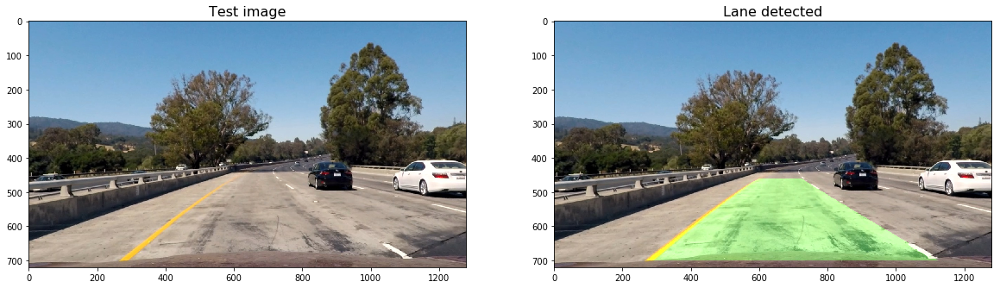

In [47]:
# Run the function
img1_lane = draw_lane(img1, cmb1_warped, left_points1, right_points1, Minv1)

# Plot the results
plt2(img1, 'Test image', img1_lane, 'Lane detected')

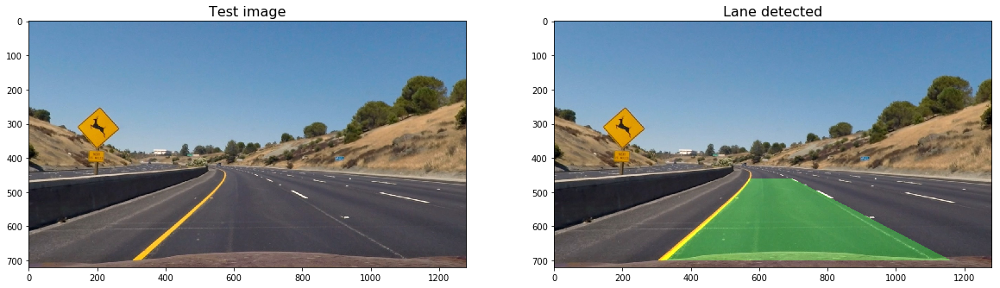

In [48]:
img2_lane = draw_lane(img2, cmb2_warped, left_points2, right_points2, Minv2)
plt2(img2, 'Test image', img2_lane, 'Lane detected')

### 7. Display lane boundaries and numerical estimation of lane curvature and vehicle position
Add curvature_radius and car_offset info into the image.

In [49]:
def add_metrics(img, leftx, rightx, xm_per_pix=3.7/800, ym_per_pix = 25/720):    
    # Calculate radius of curvature
    curvature_rads = curvature_radius(leftx=leftx, rightx=rightx, img_shape=img.shape,
                                      xm_per_pix=xm_per_pix, ym_per_pix=ym_per_pix)
    # Calculate car offset
    offsetx = car_offset(leftx=leftx, rightx=rightx, img_shape=img.shape)

    # Display lane curvature
    out_img = img.copy()
    cv2.putText(out_img, 'Left lane line curvature: {:.2f} m'.format(curvature_rads[0]), 
                (60, 60), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 5)
    cv2.putText(out_img, 'Right lane line curvature: {:.2f} m'.format(curvature_rads[1]), 
                (60, 110), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 5)
    
    # Display car offset
    cv2.putText(out_img, 'Horizontal car offset: {:.2f} m'.format(offsetx), 
                (60, 160), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 5)
    
    return out_img

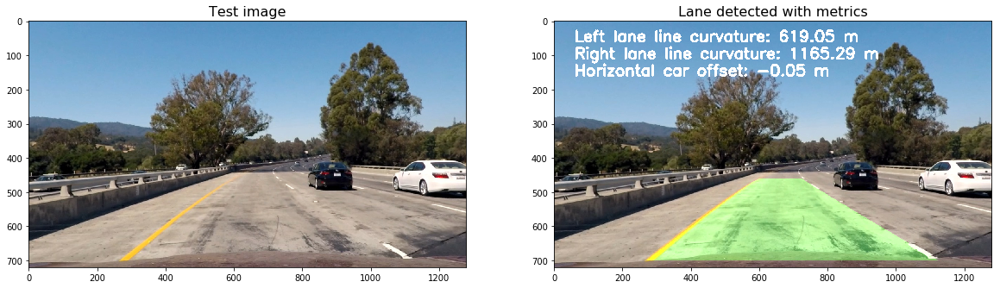

In [50]:
# Run the function
out1_img = add_metrics(img1_lane, leftx=left_points1[0], rightx=right_points1[0])

# Plot the results
plt2(img1, 'Test image', out1_img, 'Lane detected with metrics')

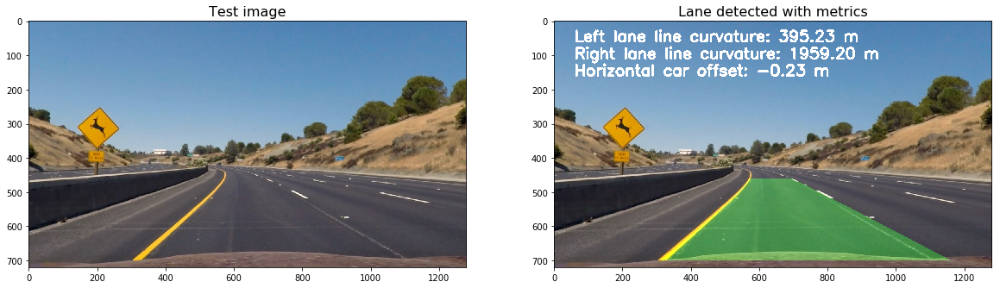

In [51]:
out2_img = add_metrics(img2_lane, leftx=left_points2[0], rightx=right_points2[0])
plt2(img2, 'Test image', out2_img, 'Lane detected with metrics')

In [58]:
cv2.imwrite("output_images/detected1.jpg", cv2.cvtColor(img1_lane, cv2.COLOR_RGB2BGR))
cv2.imwrite("output_images/detected2.jpg", cv2.cvtColor(img2_lane, cv2.COLOR_RGB2BGR))
cv2.imwrite("output_images/detected1_info.jpg", cv2.cvtColor(out1_img, cv2.COLOR_RGB2BGR))
cv2.imwrite("output_images/detected2_info.jpg", cv2.cvtColor(out2_img, cv2.COLOR_RGB2BGR))

True

## Pipeline (video)

Provide a link to your final video output. Your pipeline should perform reasonably well on the entire project video (wobbly lines are ok but no catastrophic failures that would cause the car to drive off the road!).

Here's a link to my video result: https://view5639f7e7.udacity-student-workspaces.com/view/CarND-Advanced-Lane-Lines/project_video_solution_clip.mp4

In [52]:
# Encaptulate all the codes in the class for video processing.
class ProcessPipeline:
    def __init__(self, chessboard_path):
        # Make a list of calibration images
        cb_imgs = glob.glob(chessboard_path)
        
        # Calibrate camera        
        self.ret, self.mtx, self.dist, self.rvecs, self.tvecs = calibrate_camera(cb_imgs)
        self.lines_fit = None

    def __call__(self, img):
        # Undistord image
        img = cv2.undistort(img, self.mtx, self.dist, None, self.mtx)
        
        # binary
        cmb = combined_thresh(img, 15, 
                      thresh_grad_x=(30, 100), thresh_grad_y=(30, 100), 
                      thresh_mag=(60, 100), thresh_dir=(0.7, 1.3), thresh_hls=(150, 255))

        # Apply a perspective transform to rectify binary image ("birds-eye view")
        src_coordinates = np.float32(
            [[280,  700],  # Bottom left
             [595,  460],  # Top left
             [725,  460],  # Top right
             [1125, 700]]) # Bottom right

        dst_coordinates = np.float32(
            [[250,  720],  # Bottom left
             [250,    0],  # Top left
             [1065,   0],  # Top right
             [1065, 720]]) # Bottom right   

        cmb_warped, _, Minv = warp(cmb, src_coordinates, dst_coordinates)
                
        self.lines_fit, left_points, right_points, out_img = fit_similar_lines(cmb_warped, self.lines_fit)

        # Warp the detected lane boundaries back onto the original image.
        img_lane = draw_lane(img, cmb_warped, left_points, right_points, Minv)
            
        # Add metrics to the output img
        out_img = add_metrics(img_lane, leftx=left_points[0], rightx=right_points[0])
            
        return out_img

In [53]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [54]:
input_video = 'project_video.mp4'
# output_video = 'project_video_solution.mp4'
output_video = 'project_video_solution_5s.mp4'

## You may uncomment the following line for a subclip of the first 5 seconds
clip1 = VideoFileClip(input_video).subclip(0,5)
#clip1 = VideoFileClip(input_video)

# Process video frames with our 'ProcessPipeline' function
process_pipeline = ProcessPipeline('camera_cal/calibration*.jpg')

write_clip = clip1.fl_image(process_pipeline)

%time write_clip.write_videofile(output_video, audio=False)

Camera successfully calibrated.
[MoviePy] >>>> Building video project_video_solution_5s.mp4
[MoviePy] Writing video project_video_solution_5s.mp4


 99%|█████████▉| 125/126 [01:24<00:00,  1.48it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_solution_5s.mp4 

CPU times: user 1min 9s, sys: 3.23 s, total: 1min 12s
Wall time: 1min 27s


In [55]:
HTML("""
<video width="640" height="360" controls>
  <source src="{0}">
</video>
""".format(output_video))

In [56]:
clip2 = VideoFileClip(input_video).subclip(0,5)

write_clip2 = clip2.fl_image(process_pipeline)

output2_video = 'project_video_solution_clip.mp4'

%time write_clip2.write_videofile(output2_video, audio=False)

[MoviePy] >>>> Building video project_video_solution_clip.mp4
[MoviePy] Writing video project_video_solution_clip.mp4


 99%|█████████▉| 125/126 [01:22<00:00,  1.44it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_solution_clip.mp4 

CPU times: user 1min 9s, sys: 3.3 s, total: 1min 12s
Wall time: 1min 25s


In [57]:
HTML("""
<video width="640" height="360" controls>
  <source src="{0}">
</video>
""".format(output2_video))

## The End